# Solar

In [71]:
#|code-fold: true
#|output: false
from IPython.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))
import matplotlib.ticker as ticker

import numpy as np
from pathlib import Path
from tqdm import tqdm
import torch
import torch.optim as optim
import torch.nn as nn
import platform
from PIL import Image
import datetime
import matplotlib.pyplot as plt
from matplotlib import cm
from torch.utils.data import DataLoader, Dataset, random_split, WeightedRandomSampler, SubsetRandomSampler
from torchvision.transforms import Compose, ToTensor, Normalize, ColorJitter, ToPILImage, RandomHorizontalFlip, Resize
import ipyplot

from step_by_step import StepByStep, InverseNormalize, load_tensor, get_means_and_stdevs 
from categorize import check_for_missing_files
from models import Segnet
plt.style.use('fivethirtyeight')

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We have accumulated labels in the `data\all_labels` folder. We need to:
- load all of them into NCWH tensors
- split them into train and valid (test labels will be separate), 
- create temporary Datasets and normalizer
- create real Datasets and DataLoaders. 

# Data processing

## Generate tensors

Let's first create a `x_tensor/y_tensor` from all_labels:

In [2]:
proj_dir = Path('.').resolve().parent
data_dir = proj_dir / 'data'
train_imgs_dir = data_dir / 'all_labels/train/imgs'
train_masks_dir = data_dir / 'all_labels/train/masks'
image_paths = sorted(list(train_imgs_dir.glob('*.png')))
mask_paths = sorted(list(train_masks_dir.glob('*.png')))
check_for_missing_files(image_paths, mask_paths)

There are {{len(image_paths)}} images.

/Users/nenad.bozinovic/mambaforge/envs/solar_panel/lib/python3.10/site-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



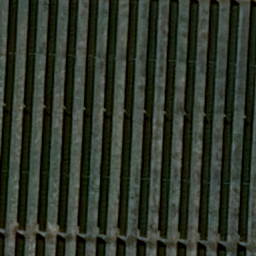
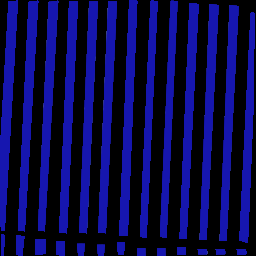


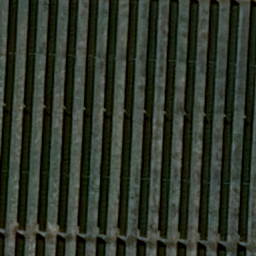
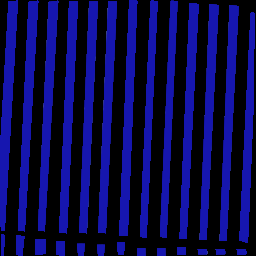

In [3]:
idx = 60
im = Image.open(image_paths[idx]).convert('RGB')
mask = Image.open(mask_paths[idx]).convert('RGB')
ipyplot.plot_images([im, mask])

For the mask, we'll use multi-class labeling:
- class 0: background, 
- class 1 (red): racks
- class 2 (green): posts
- class 3 (blue): solar panels

In [4]:
title_mapping = {-1: 'out-of-scope', 0: 'background', 1: 'racks', 2: 'posts', 3: 'panels'}


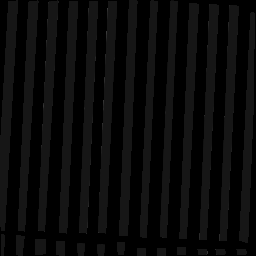
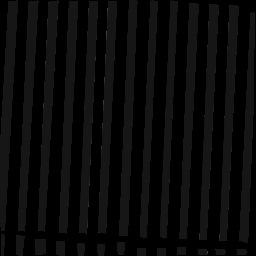
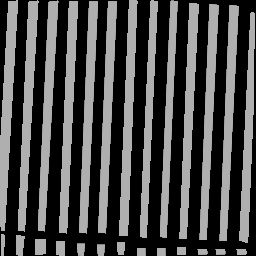


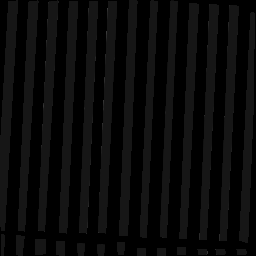
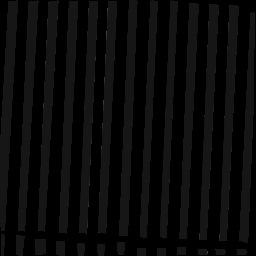
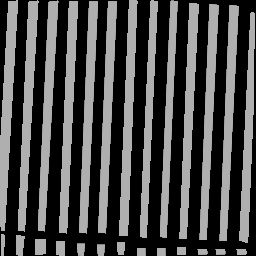

In [5]:
ipyplot.plot_images([mask.getchannel('R'), 
                     mask.getchannel('G'),
                     mask.getchannel('B')])

Let's come up with the RGB mask conversion to class (i.e. post/rack/panel). First we will extracts the mask class_id, basically most prevalent color, can be 0(red), 1(green), or 2(blue)
Then we take only that color channel and  convert it to class. 

In [6]:
def get_tensors(image_paths, mask_paths):

    n_channels, h, w = ToTensor()(Image.open(image_paths[0]).convert('RGB')).shape

    x_tensor = torch.zeros([len(image_paths), n_channels, h, w])
    y_tensor = torch.zeros([len(image_paths), h, w], dtype=torch.long)  # we'll have only class number mask

    for i, (image_path, mask_path) in enumerate(zip(tqdm(image_paths), mask_paths)):
        x_tensor[i,:,:,:] = ToTensor()(Image.open(image_path).convert('RGB'))

        mask = Image.open(mask_path).convert('RGB')
        mask_tensor = ToTensor()(mask)
        # let's extracts the class_id (post, rack, panel) by seeing what's the most prevalent color, can be 0(red), 1(green), or 2(blue)
        # we don't have mixed labels
        class_id = int(mask_tensor.flatten(1,2).max(axis=1).values.argmax())
        # take only that color channel
        mask_tensor = mask_tensor[class_id, :, :]
        # make it binary
        mask_tensor = mask_tensor > mask_tensor.min()
        mask_tensor = mask_tensor.long()
        # multiply with class_id + 1 
        mask_tensor *= (class_id + 1)

        # label out-of-scope pixels as -1 if blue channel is 0, can be any:
        mask_tensor.masked_fill_(x_tensor[i,2,:,:] == 0, -1)  

        y_tensor[i,:,:] = mask_tensor

    return x_tensor, y_tensor 

In [7]:
x_tensor, y_tensor = get_tensors(image_paths, mask_paths)

100%|██████████| 352/352 [00:03<00:00, 115.07it/s]


In [8]:
print(x_tensor.shape)
print(y_tensor.shape)
print(x_tensor.dtype)
print(y_tensor.dtype)

torch.Size([352, 3, 256, 256])
torch.Size([352, 256, 256])
torch.float32
torch.int64


## Split into train and valid

We'll use `torch.utils.data.random_split`:

In [9]:
torch.manual_seed(13)  # Important for consistency
N = len(x_tensor)
n_train = int(.8*N)
n_val = N - n_train
train_subset, val_subset = random_split(x_tensor, [n_train, n_val])

train_idx = train_subset.indices
val_idx = val_subset.indices

print(len(train_idx))
print(len(val_idx))

281
71


In [10]:
x_train_tensor = x_tensor[train_idx]
y_train_tensor = y_tensor[train_idx]

x_val_tensor = x_tensor[val_idx]
y_val_tensor = y_tensor[val_idx]

In [11]:
print(x_train_tensor.shape)
print(y_train_tensor.shape)
print(x_val_tensor.shape)
print(y_val_tensor.shape)

torch.Size([281, 3, 256, 256])
torch.Size([281, 256, 256])
torch.Size([71, 3, 256, 256])
torch.Size([71, 256, 256])


In [12]:
print(x_train_tensor.dtype)
print(y_train_tensor.dtype)
print(x_val_tensor.dtype)
print(y_val_tensor.dtype)

torch.float32
torch.int64
torch.float32
torch.int64


**NOTE, it is very important that y_tensor is of shape (N, d1, d2)**

Since this is unbalanced dataset, we find contributions for each class:

In [13]:
n_classes = 4
contributions = np.array([(y_train_tensor == i).float().sum() for i in range(-1, n_classes)])
# contributions = [(y_train_tensor == i).float().sum() / np.prod(y_train_tensor.shape) for i in range(-1, n_classes)]weig
contributions

array([  383238., 13708546.,   736934.,        0.,  3586898.],
      dtype=float32)

In [14]:
weights = np.zeros(n_classes)
for i, contrib in enumerate(contributions[1:]):
    if contrib != 0:
        weights[i] = 1.0 / contrib
weights = weights / weights.sum() * n_classes
torch.tensor(weights)

tensor([0.1708, 3.1766, 0.0000, 0.6526], dtype=torch.float64)

## Temporary Datasets

Our very simple dataset with transform:

In [15]:
class TransformedTensorDataset(Dataset):
    def __init__(self, x, y, transform=None):
        self.x = x
        self.y = y
        self.transform = transform
        
    def __getitem__(self, index):
        x = self.x[index]
        
        if self.transform:
            x = self.transform(x)
        
        return x, self.y[index]
        
    def __len__(self):
        return len(self.x)

Let's first create **temporary** `Dataset` to extract normalization parameters:

In [19]:
temp_train_dataset = TransformedTensorDataset(x_train_tensor, y_train_tensor)
temp_train_loader = DataLoader(temp_train_dataset, batch_size=32)

In [20]:
normalizer = StepByStep.make_normalizer(temp_train_loader)
normalizer

Normalize(mean=tensor([0.2625, 0.2563, 0.2021]), std=tensor([0.0938, 0.0910, 0.0925]))

In [21]:
normalizer = StepByStep.make_normalizer(temp_train_loader, include_out_of_bounds=False)
normalizer

Normalize(mean=tensor([0.2695, 0.2631, 0.2076]), std=tensor([0.0899, 0.0870, 0.0898]))

## Real Datasets and Loaders

Let's now create **real** `Datasets` and `DataLoaders`:

In [22]:
train_composer = Compose([normalizer])  # train_composer will have augmentations later
val_composer = Compose([normalizer])

train_dataset = TransformedTensorDataset(x_train_tensor, y_train_tensor, transform=train_composer)
val_dataset = TransformedTensorDataset(x_val_tensor, y_val_tensor, transform=val_composer)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32)

# Training prep

Let's now define model, optimizer, and loss.

## Model

In [23]:
segnet = Segnet(n_channels=3, n_classes=4)
x, y = next(iter(train_loader))
segnet.eval()  # sets the mode
yhat = segnet(x)
yhat.shape

torch.Size([32, 4, 256, 256])

Cool, it checks out (we got 4 classes out).  

# Predictions from logits

For predictions we'll simply get the `argmax` accross class dimension (axis=1) (no need to convert to probabilities via `Softmax` since the results will be the same):

In [24]:
predictions_argmax = yhat.argmax(1)  # accross all classes, i.e. 1st dimension

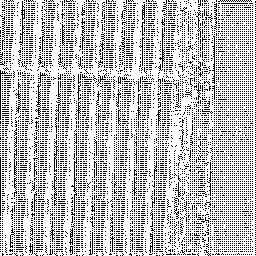

In [25]:
b = predictions_argmax[0,:,:].float()  # convert Tensor to PIL
ToPILImage()(b)

While the predictions are not great after one epoch only, we are starting to notice the shape of the solar panels already.

## Visualization

The original image looks like:

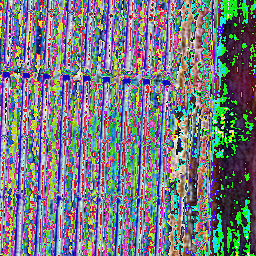

In [26]:
ToPILImage()(x[0,:,:,:])

and this looks weird since image was already normalized. Just for ploting, we can unnormalize it:

In [27]:
inv_normalizer = InverseNormalize(normalizer)

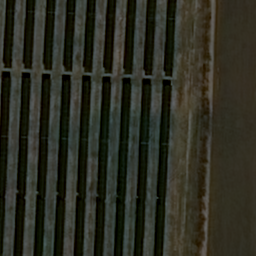

In [28]:
ToPILImage()(inv_normalizer(x[0,:,:,:]))

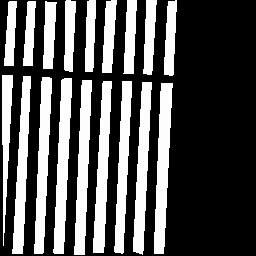

In [29]:
ToPILImage()(y[0,:,:].float())

## Optimizer and Loss

Let's define optimizer:

In [30]:
optimizer = optim.Adam(segnet.parameters(), lr=3e-4)

and loss, where we exclude out-of-bounds region:

In [31]:
def multi_loss_fn(y_pred, y_true):
    # TODO 1) try also different losses, from https://deeplearning.berlin/satellite%20imagery/computer%20vision/fastai/2021/02/17/Building-Detection-SpaceNet7.html
    # CrossEntropyLossFlat(axis=1)
    
    out_of_bounds = (y_true == -1) # find out the out-of-bounds
    # replace out-of-bounds pixels with zeros
    return nn.CrossEntropyLoss()(y_pred.masked_fill(out_of_bounds.unsqueeze(axis=1), 0), 
                                 y_true.masked_fill(out_of_bounds, 0))

    # return nn.CrossEntropyLoss()(y_pred, y_true)  # default

In [32]:
torch.manual_seed(17)
sbs = StepByStep(segnet, optimizer, multi_loss_fn)
sbs.set_loaders(train_loader, val_loader)

# Training

In [36]:
sbs.train(6)

100%|██████████| 6/6 [06:10<00:00, 61.71s/it]


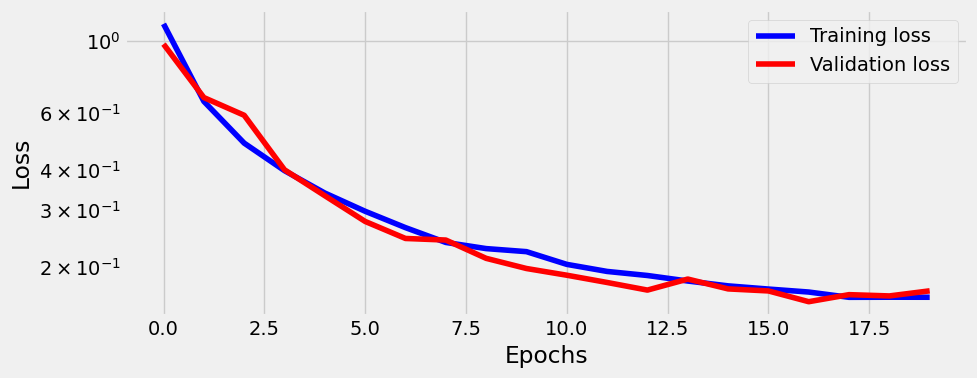

In [37]:
_ = sbs.plot_losses()

Let's visualize some of the predictions for `val_loader`:

In [38]:
val_loader_iter = iter(val_loader)

In [39]:
x_val, y_val = next(val_loader_iter)

In [40]:
def convert_class_mask_to_rgb_image(im):
    b = np.zeros([256,256, 3], dtype='uint8')
    for class_id in range(3):
        b[:,:,class_id] = np.array((im == (class_id+1))*255, dtype='uint8')
    return b

def display_images(x_batch, y_batch, show_original=False, normalizer=None, idx_map=None, idx_offset=0):
    if show_original:
        inv_normalizer = InverseNormalize(normalizer)
    
    if len(x_batch) > 64:
        raise Warning(f"There are {len(x_batch)} images to show, I set the limit to 64.")
        return
    
    y_pred_batch = sbs.predict(x_batch, to_numpy=False)
    
    # take care of out-of-bounds regions
    out_of_bounds = y_batch == -1
    y_pred_batch.masked_fill_(out_of_bounds.unsqueeze(1), 0).detach().cpu().numpy()

    for idx in range(len(x_batch)):
        # convert to PIL images
        img_a = Image.fromarray(convert_class_mask_to_rgb_image(y_pred_batch.argmax(1)[idx,:,:]))
        img_b = ToPILImage()(y_batch[idx,:,:].float())
        if show_original:
            img_c = ToPILImage()(inv_normalizer(x_batch[idx,:,:,:]))
        
        N = 3 if show_original else 2
        fig, ax = plt.subplots(1,N)
        ax[0].imshow(img_a)
        ax[0].set_title(f"{idx_offset + idx} - {'' if not idx_map else idx_map[idx_offset + idx]}")
        ax[1].imshow(img_b)
        if show_original: 
            ax[2].imshow(img_c)
        for i in range(N):
            ax[i].grid(False)
            ax[i].xaxis.set_major_locator(ticker.NullLocator())
            ax[i].yaxis.set_major_locator(ticker.NullLocator())
        plt.show()

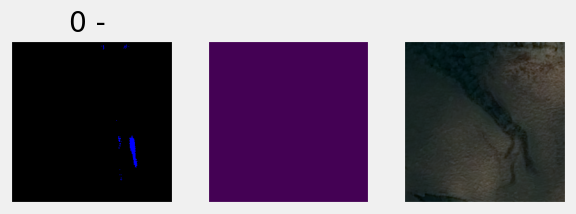

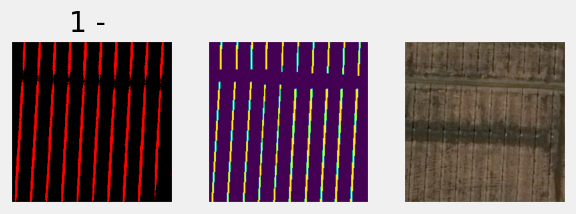

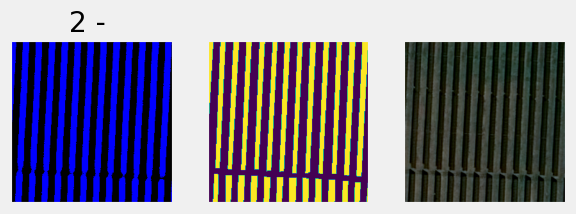

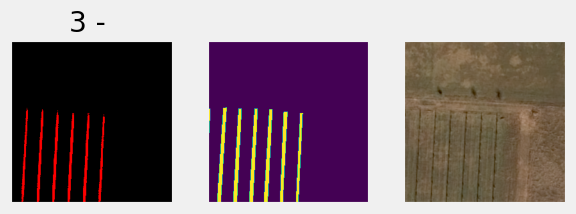

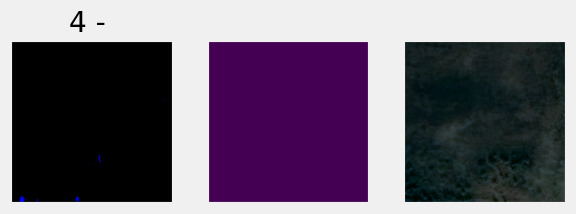

...

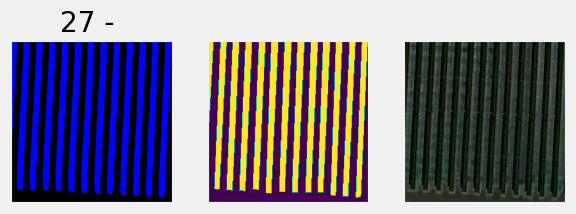

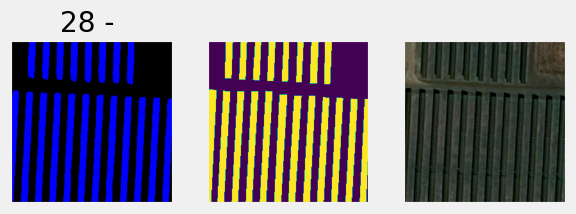

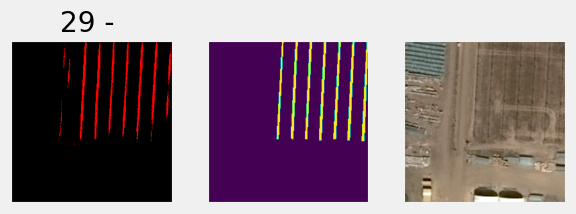

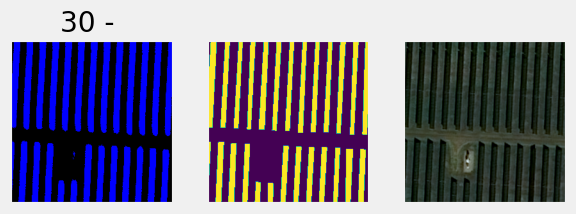

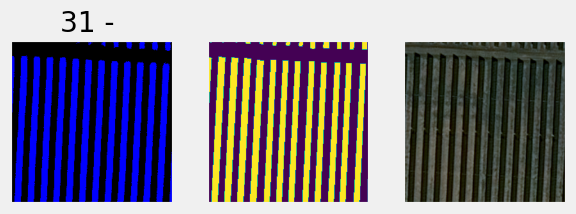

In [41]:
display_images(x_val, y_val, True, normalizer)

And this looks pretty good. We should come up with the Dyce metric for this.

Let's save the model:

In [52]:
sbs.save_checkpoint('2022_01_10_multi_class_segnet.tar')

to load the model reinitialize the sbs (with model, optimizer, and loss), then run:

In [34]:
# sbs.load_checkpoint('2022_01_09_multi_class_segnet.tar')

# Evaluation

## Evaluation dataset

Let's evaluate the model on unseen images. First we'll generate an `x_eval_tensor`:

In [43]:
eval_imgs_dir = data_dir / '6126758101/IMG_PHR1B_PMS-N_001/cropped'
eval_image_paths = sorted(list(eval_imgs_dir.glob('*.png')))

There are {{len(eval_image_paths)}} test images, which is a lot, let's look into 500 only.

In [44]:
N = len(eval_image_paths)  # 500

In [45]:
tensorizer = ToTensor()
n_channels, h, w = ToTensor()(Image.open(eval_image_paths[0]).convert('RGB')).shape

x_eval_tensor = torch.zeros([len(eval_image_paths[:N]), n_channels, h, w])
y_eval_tensor = torch.zeros([len(eval_image_paths[:N]), h, w], dtype=torch.long)  # we'll have only class number mask
idx_map = {}

for i, image_path in enumerate(tqdm(eval_image_paths[:N])):
    x_eval_tensor[i, :, :, :] = ToTensor()(Image.open(image_path))
    
    mask_tensor = torch.zeros(*x_eval_tensor.shape[2:])
    mask_tensor.masked_fill_(x_eval_tensor[i,2,:,:] == 0, -1)  # labels-out-of-scope regions as -1, these will be removed later
    y_eval_tensor[i,:,:] = mask_tensor
    
    idx_map[i] = image_path.name

100%|██████████| 6529/6529 [00:36<00:00, 180.24it/s]


In [46]:
x_eval_tensor_size = x_eval_tensor.element_size() * x_eval_tensor.nelement() / (10**9)

The `x_eval_tensor` is {{x_eval_tensor_size}} Gb.

Next we create a dataset, we'll reuse `val_composer` since it contains only normalization:

In [47]:
eval_dataset = TransformedTensorDataset(x_eval_tensor, y_eval_tensor, transform=val_composer)
batch_size = 32
eval_loader = DataLoader(eval_dataset, batch_size=batch_size)
eval_loader_iter = iter(eval_loader)
batch_idx = -1

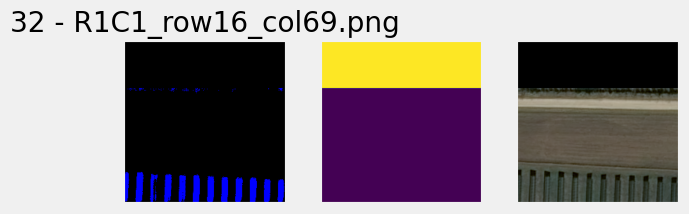

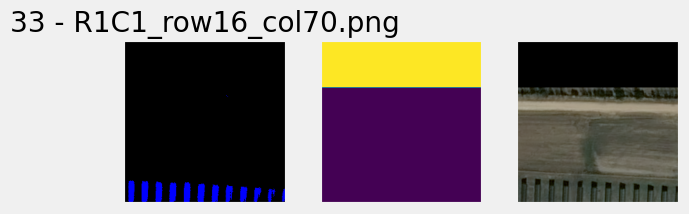

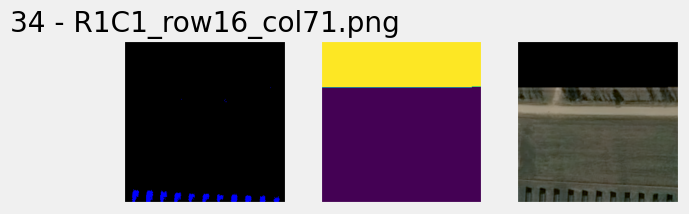

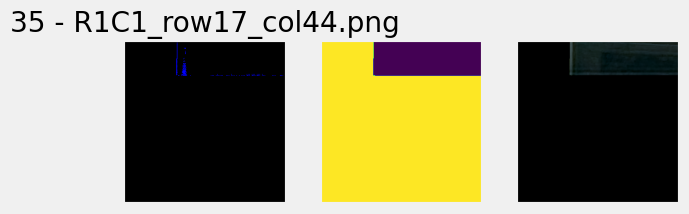

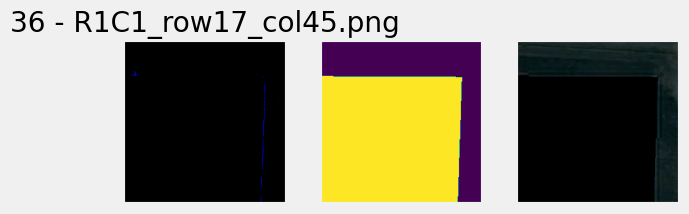

...

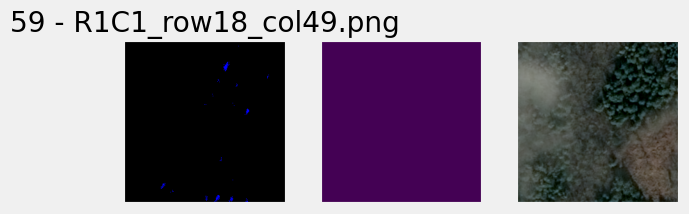

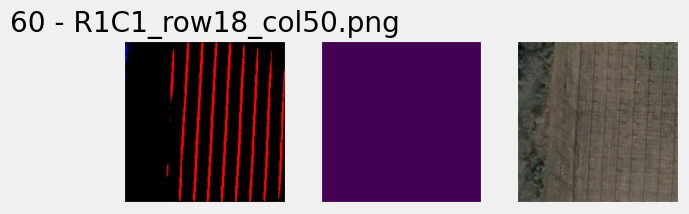

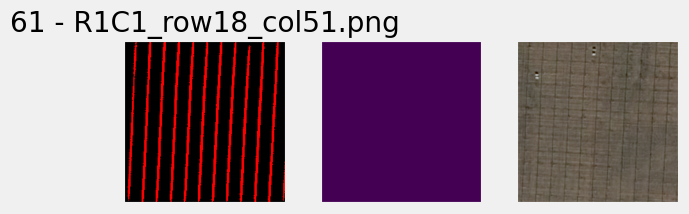

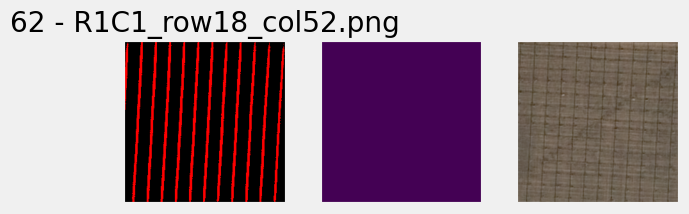

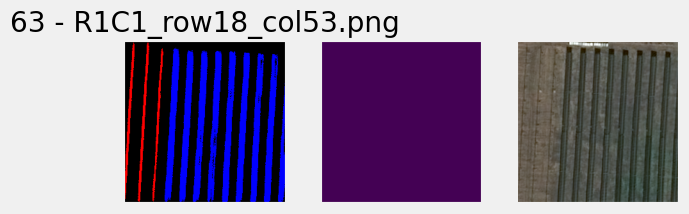

In [84]:
(x_eval, y_eval), batch_idx = next(eval_loader_iter), batch_idx + 1 
display_images(x_eval, y_eval, True, normalizer, idx_map, batch_idx*batch_size)

It is starting to look decent. Adding non-solar-panels images to the training dataset helped to get rid of false positives, and adding variety of solar-panel images to the training dataset is helping too.

## mean/stdev plots

To see the range of mean and stdev accross `train` and `eval` datasets, let's look into mean and stdev for **individial** images, i.e. mean and stdev accross channels for all training and eval images **before** normalization. A straightforward way to do this is by using `x_train_tensor` and `x_eval_tensor`:

In [69]:
def plot_means_and_stdevs(means, stdevs, legend):
    fig, axs = plt.subplots(1,3, figsize=(10,3))
    for i in range(3):
        for the_mean, the_stdev in zip(means, stdevs):
            axs[i].plot(the_mean[:,i], the_stdev[:,i], '.')
        axs[i].set_xlabel('means')
        axs[i].set_ylabel('stdev')
        axs[i].set_title(f'Channel #{i+1}')
        axs[i].legend(legend)
    plt.show()

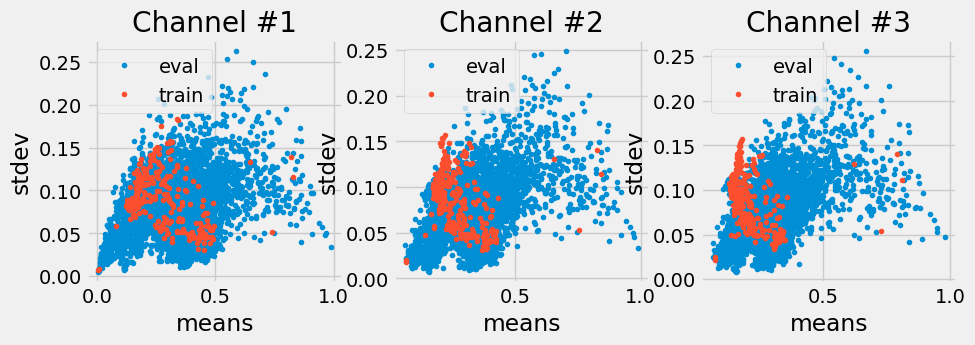

In [76]:
train_means, train_stdevs = get_means_and_stdevs(x_train_tensor, include_out_of_bounds=False)
eval_means, eval_stdevs = get_means_and_stdevs(x_eval_tensor, include_out_of_bounds=False)
plot_means_and_stdevs((eval_means, train_means), (eval_stdevs, train_stdevs), ['eval', 'train'])

Let's now plot a similar versions using `normalizer`:

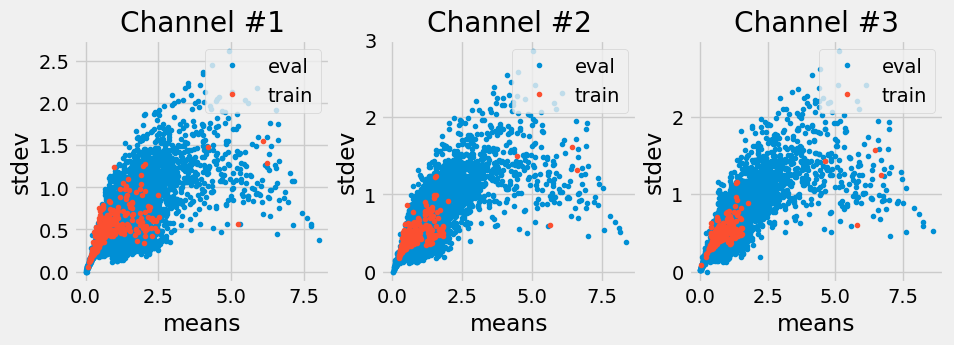

In [77]:
train_means_normalized, train_stdevs_normalized = get_means_and_stdevs(normalizer(x_train_tensor), include_out_of_bounds=False)
eval_means_normalized, eval_stdevs_normalized = get_means_and_stdevs(normalizer(x_eval_tensor), include_out_of_bounds=False)
plot_means_and_stdevs((eval_means_normalized, train_means_normalized), (eval_stdevs_normalized, train_stdevs_normalized), ['eval', 'train'])

and we are now starting to get better coverage of the actual eval images.

## Augmentations

Let's dig deeper to see what are the zones we did not cover. Let's take a look at everything that has mean more then 0.5 for example, we have only few images and could use more coverage there:

In [78]:
def plot_zone(some_tensor, some_filter):
    zone_tensor = some_tensor[(some_filter).sum(axis=1) > 1]
    zone_images = [ToPILImage()(temp) for temp in zone_tensor]
    ipyplot.plot_images(zone_images, max_images=100)

/Users/nenad.bozinovic/mambaforge/envs/solar_panel/lib/python3.10/site-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



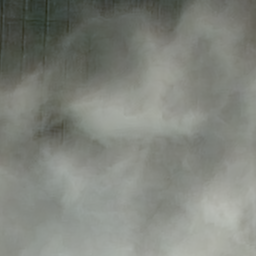
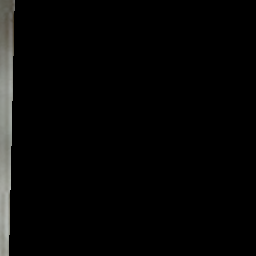
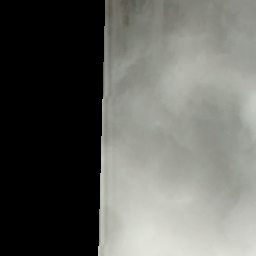
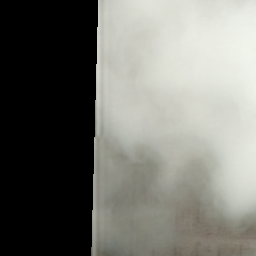
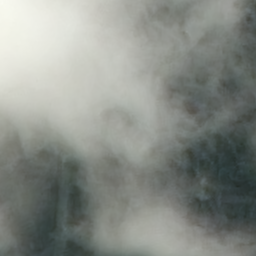
...
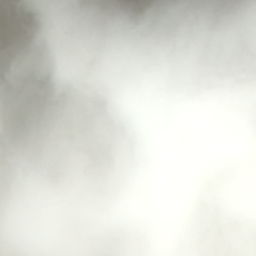
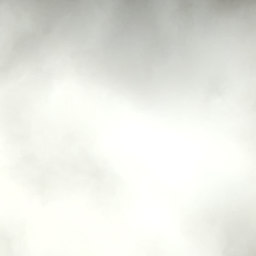
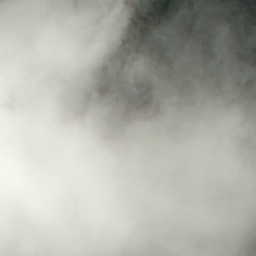
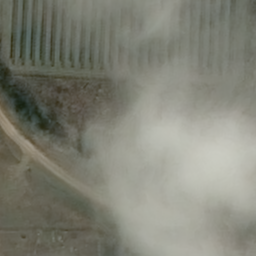
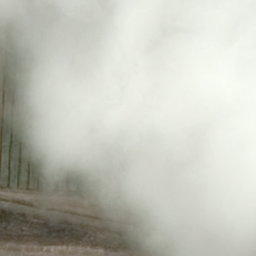

In [79]:
plot_zone(x_eval_tensor, eval_means >0.5)

and these are all clouds (makes sense, high mean, low stdev). We don't have to seem issues with false positives with clouds so we might be even good, and not have to add more cloud images.

How about on the other end, where mean is less then 0.1:


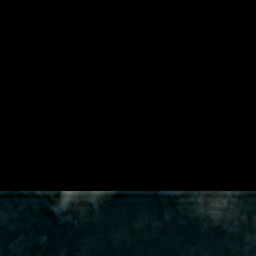
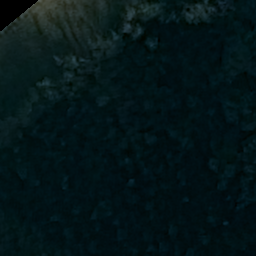
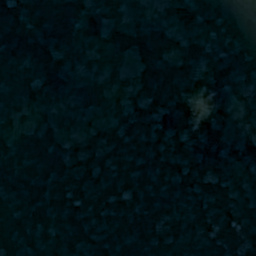
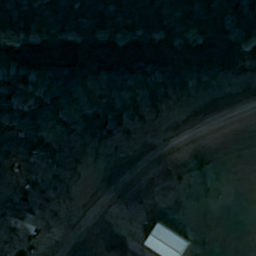
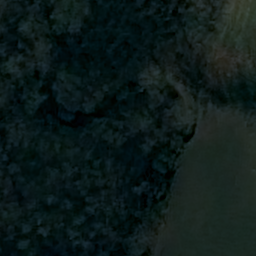
...
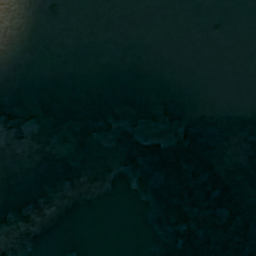
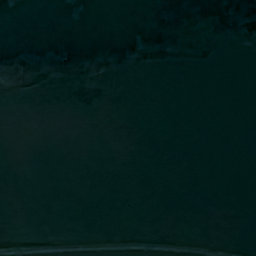
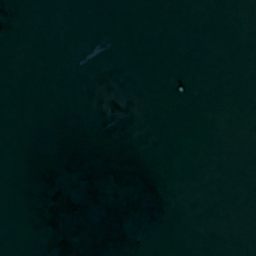
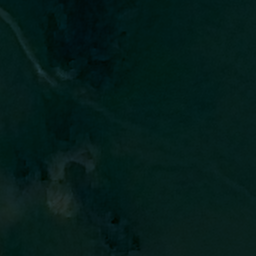
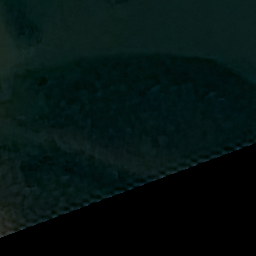

In [80]:
plot_zone(x_eval_tensor, eval_means <0.1)

Very dark images of course. Since we do have some issues with false positives here, we should add more of these.

Finally we have some high stdev images:


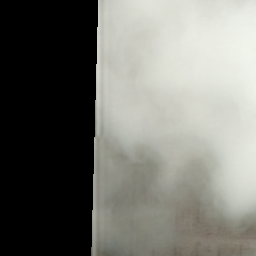
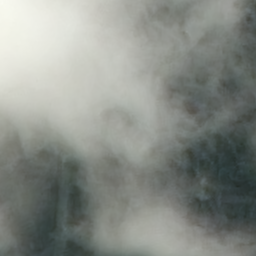
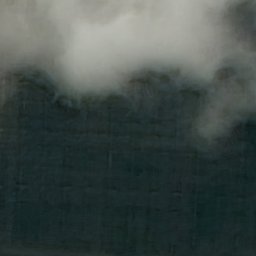
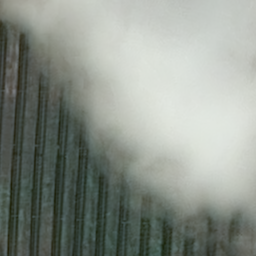
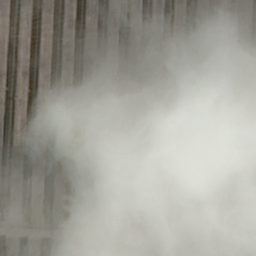
...
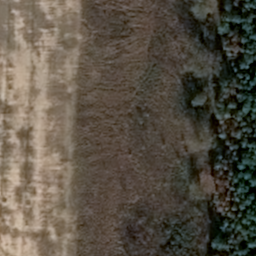
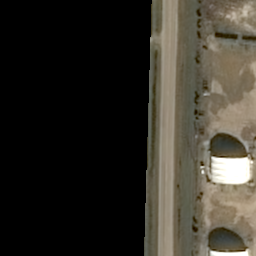
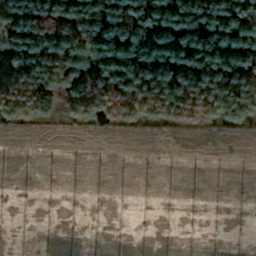
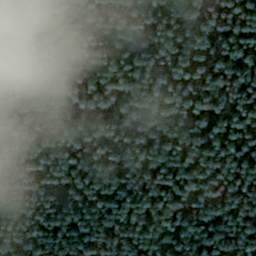
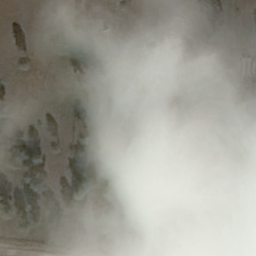

In [82]:
plot_zone(x_eval_tensor, eval_stdevs > 0.15)

These are mix of clouds and land (hence high std). We should add these as well.

We can also add some brightness jitter to mimic shadows:

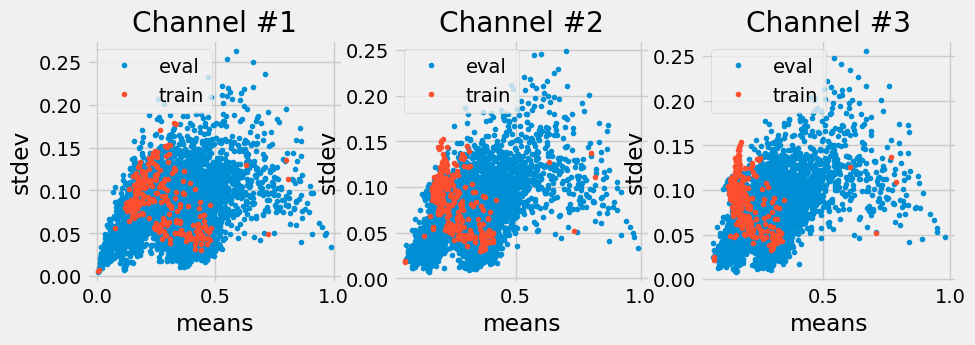

In [83]:
train_means, train_stdevs = get_means_and_stdevs(ColorJitter(brightness=(0.5, 1))(x_train_tensor), include_out_of_bounds=False)
eval_means, eval_stdevs = get_means_and_stdevs(x_eval_tensor, include_out_of_bounds=False)
plot_means_and_stdevs((eval_means, train_means), (eval_stdevs, train_stdevs), ['eval', 'train'])

## Add background-only training images

Let's create a background mask:

In [682]:
from categorize import LABELS, load_paths, check_for_missing_files

In [101]:
background_mask = Image.fromarray(np.zeros([256, 256], dtype=np.uint8))

In [103]:
label_type = 'background'
background_mask.save(LABELS / label_type / 'masks/background.png')

get all the names from `imgs` folder:

In [116]:
image_paths, mask_paths = load_paths(label_type)
check_for_missing_files(image_paths, mask_paths)

In [115]:
import shutil
dst_folder = LABELS / label_type / 'masks'
for image_path in image_paths:
    shutil.copy(dst_folder / 'background.png', dst_folder / image_path.name)

## Dice coeficient


Dice coefficient quantifies our model ...